<a href="https://colab.research.google.com/github/dtas1917/ball-simulation/blob/main/simulation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

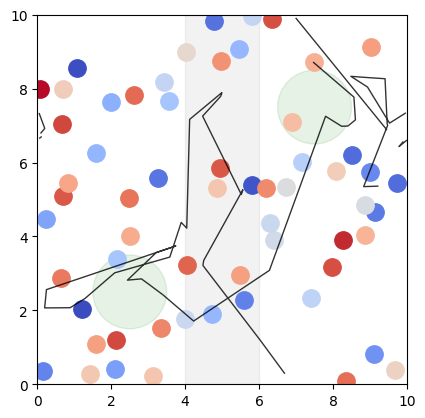

In [28]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display
from matplotlib import cm
from matplotlib.patches import Circle, Rectangle
import ipywidgets as widgets

plt.rcParams['animation.embed_limit'] = 2**128


ball_slider = widgets.IntSlider(value=200, min=10, max=500, step=10, description='Number of Balls')
radius_slider = widgets.FloatSlider(value=0.25, min=0.05, max=1.0, step=0.05, description='Ball Radius')
strength_slider = widgets.FloatSlider(value=0.2, min=0.0, max=1.0, step=0.05, description='Field Strength')
field_width_slider = widgets.FloatSlider(value=2.0, min=0.5, max=5.0, step=0.1, description='Field Width')
circle_strength_slider = widgets.FloatSlider(value=0.5, min=0.0, max=2.0, step=0.1, description='Circle Strength')
circle_radius_slider = widgets.FloatSlider(value=1.0, min=0.2, max=3.0, step=0.1, description='Circle Radius')
sigma_slider = widgets.FloatSlider(value=0.5, min=0.1, max=2.0, step=0.1, description='Sigma')
epsilon_slider = widgets.FloatSlider(value=0.1, min=0.01, max=1.0, step=0.01, description='Epsilon')
duration_slider = widgets.IntSlider(value=300, min=50, max=1000, step=50, description='Frames')
vmax_slider = widgets.FloatSlider(value = 10.0, min= 1.0, max= 100.0, step = 1.0, description = 'vmax')
run_button = widgets.Button(description="Start Simulation")

display(widgets.VBox([
    ball_slider,
    radius_slider,
    strength_slider,
    field_width_slider,
    circle_strength_slider,
    circle_radius_slider,
    sigma_slider,
    epsilon_slider,
    duration_slider,
    vmax_slider,
    run_button
]))


def run_simulation(_):

    box_size = 10
    radius = radius_slider.value
    my_markersize = radius * 50
    num_of_balls = ball_slider.value
    dt = 0.05
    field_center = 5.0
    field_width = field_width_slider.value
    field_strength = strength_slider.value
    circle_strength = circle_strength_slider.value
    circle_radius = circle_radius_slider.value
    sigma = sigma_slider.value
    epsilon = epsilon_slider.value
    duration = duration_slider.value
    v_max = vmax_slider.value

    circle_fields = [
        {"cx": 2.5, "cy": 2.5, "radius": circle_radius, "strength": circle_strength},
        {"cx": 7.5, "cy": 7.5, "radius": circle_radius, "strength": circle_strength}
    ]

    velocities = np.random.uniform(1, 5, size=num_of_balls)
    angle_rad = np.radians(np.random.uniform(0, 360, size=num_of_balls))
    min_mass = 1
    max_mass = 5

    balls = []
    for i in range(num_of_balls):
        mass = np.random.uniform(min_mass, max_mass)
        normalized_mass = (mass - min_mass) / (max_mass - min_mass)
        color = cm.coolwarm(normalized_mass)
        balls.append({
            "x": np.random.uniform(radius, box_size - radius),
            "y": np.random.uniform(radius, box_size - radius),
            "vx": velocities[i] * np.cos(angle_rad[i]),
            "vy": velocities[i] * np.sin(angle_rad[i]),
            "color": color,
            "mass": mass
        })

    fig, ax = plt.subplots()
    ax.set_xlim(0, box_size)
    ax.set_ylim(0, box_size)
    ax.set_aspect('equal')

    ball_objs = []
    for b in balls:
        ball_obj, = ax.plot([], [], 'o', color=b["color"], markersize=my_markersize)
        ball_objs.append(ball_obj)

    field_bilder = []
    for c_field in circle_fields:
        bild = Circle((c_field["cx"], c_field["cy"]), c_field["radius"], color="green", alpha=0.1)
        ax.add_patch(bild)
        field_bilder.append(bild)

    center_field_patch = Rectangle((4, 0), 2, box_size, color="grey", alpha=0.1)
    ax.add_patch(center_field_patch)


    trajectory_x = []
    trajectory_y = []
    trajectory_line, = ax.plot([], [], color='black', linewidth=1, alpha=0.8)

    def start():
        for ball, obj in zip(balls, ball_objs):
            obj.set_data([ball["x"]], [ball["y"]])
            trajectory_line.set_data([], [])
        return tuple(ball_objs + field_bilder + [center_field_patch, trajectory_line])

    def update(frame):

        for ball in balls:
            if abs(ball["x"] - field_center) < field_width / 2:
                abstand_center = field_center - ball["x"]
                if abstand_center > 0 and ball["vx"] > 0:
                    ball["vx"] += -field_strength * ball["vx"]
                    ball["vy"] += -field_strength * ball["vy"]
                if abstand_center > 0 and ball["vx"] < 0:
                    ball["vx"] += -field_strength * ball["vx"]
                    ball["vy"] += -field_strength * ball["vy"]
                if abstand_center < 0 and ball["vx"] < 0:
                    ball["vx"] += field_strength * ball["vx"]
                    ball["vx"] += field_strength * ball["vy"]
                if abstand_center < 0 and ball["vx"] > 0:
                    ball["vx"] += field_strength * ball["vx"]
                    ball["vx"] += field_strength * ball["vy"]

            for c_field in circle_fields:
                dcx = c_field["cx"] - ball["x"]
                dcy = c_field["cy"] - ball["y"]
                c_abstand = np.hypot(dcx, dcy)
                if c_abstand < c_field["radius"]:
                    cx_abstand_center = c_field["cx"] - ball["x"]
                    cy_abstand_center = c_field["cy"] - ball["y"]
                    if cx_abstand_center > 0 and ball["vx"] > 0:
                        ball["vx"] += -c_field["strength"] * ball["vx"]
                    if cy_abstand_center > 0 and ball["vy"] > 0:
                        ball["vy"] += -c_field["strength"] * ball["vy"]
                    if cx_abstand_center < 0 and ball["vx"] > 0:
                        ball["vx"] += c_field["strength"] * ball["vx"]
                    if cy_abstand_center < 0 and ball["vy"] > 0:
                        ball["vy"] += c_field["strength"] * ball["vy"]
                    if cx_abstand_center > 0 and ball["vx"] < 0:
                        ball["vx"] += -c_field["strength"] * ball["vx"]
                    if cy_abstand_center > 0 and ball["vy"] < 0:
                        ball["vy"] += -c_field["strength"] * ball["vy"]
                    if cx_abstand_center < 0 and ball["vx"] < 0:
                        ball["vx"] += c_field["strength"] * ball["vx"]
                    if cy_abstand_center < 0 and ball["vy"] < 0:
                        ball["vy"] += c_field["strength"] * ball["vy"]


        for i in range(num_of_balls):
            for j in range(i + 1, num_of_balls):
                dx = balls[j]["x"] - balls[i]["x"]
                dy = balls[j]["y"] - balls[i]["y"]



                if dx > box_size / 2:
                    dx -= box_size
                elif dx < -box_size / 2:
                    dx += box_size


                if dy > box_size / 2:
                    dy -= box_size
                elif dy < -box_size / 2:
                    dy += box_size



                r2 = dx ** 2 + dy ** 2
                if r2 == 0 or r2 < (0.1 * sigma) ** 2 or r2 > (2.5 * sigma) ** 2:
                    continue


                r = np.sqrt(r2)
                r7 = r ** 7
                r13 = r ** 13
                force_lj = 24 * epsilon * (2 * ((sigma / r) ** 13 ) - ((sigma / r) ** 7))

                force_lj = np.clip(force_lj, -1000, 1000)

                fx = force_lj * dx
                fy = force_lj * dy

                balls[i]["vx"] -= fx / balls[i]["mass"] * dt
                balls[i]["vy"] -= fy / balls[i]["mass"] * dt
                balls[j]["vx"] += fx / balls[j]["mass"] * dt
                balls[j]["vy"] += fy / balls[j]["mass"] * dt


        for i in range(num_of_balls):
            for j in range(i + 1, num_of_balls):
                dx = balls[j]["x"] - balls[i]["x"]
                dy = balls[j]["y"] - balls[i]["y"]
                abstand = np.hypot(dx, dy)
                if abstand <= 2 * radius:
                    dvx = balls[j]["vx"] - balls[i]["vx"]
                    dvy = balls[j]["vy"] - balls[i]["vy"]
                    sca = dvx * dx + dvy * dy
                    if sca < 0:
                        m1 = balls[i]["mass"]
                        m2 = balls[j]["mass"]
                        proj = (2 * sca) / ((m1 + m2) * abstand ** 2)
                        projx = proj * dx
                        projy = proj * dy
                        balls[i]["vx"] += projx * m2
                        balls[i]["vy"] += projy * m2
                        balls[j]["vx"] -= projx * m1
                        balls[j]["vy"] -= projy * m1


        for ball, obj in zip(balls, ball_objs):
            ball["vx"] = np.clip(ball["vx"], -v_max, v_max)
            ball["vy"] = np.clip(ball["vy"], -v_max, v_max)
            ball["x"] += ball["vx"] * dt
            ball["y"] += ball["vy"] * dt
            if ball["x"] < 0: ball["x"] += box_size
            elif ball["x"] > box_size: ball["x"] -= box_size
            if ball["y"] < 0: ball["y"] += box_size
            elif ball["y"] > box_size: ball["y"] -= box_size
            obj.set_data([ball["x"]], [ball["y"]])


        trajectory_x.append(balls[0]["x"])
        trajectory_y.append(balls[0]["y"])

        if len(trajectory_x) > 1:
            dx = abs(trajectory_x[-1] - trajectory_x[-2])
            dy = abs(trajectory_y[-1] - trajectory_y[-2])
            if dx > box_size / 2 or dy > box_size / 2:
                trajectory_x[-1] = np.nan
                trajectory_y[-1] = np.nan

        trajectory_line.set_data(trajectory_x, trajectory_y)

        return tuple(ball_objs + field_bilder + [center_field_patch, trajectory_line])

    global ani
    ani = animation.FuncAnimation(
        fig, update,
        frames=duration,
        init_func=start,
        blit=True,
        interval=dt * 1000
    )

    display(HTML(ani.to_jshtml()))


run_button.on_click(run_simulation)